
# Prepare data for classification

Use two trained networks to predict os/cervix masks, merge results to create a final os/cervix mask for all train/test data.




In [1]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
from datetime import datetime
from glob import glob
    
# Project
project_common_path = os.path.abspath(os.path.join('..', 'common'))
if not project_common_path in sys.path:
    sys.path.append(project_common_path)    

from data_utils import type_1_ids, type_2_ids, type_3_ids, test_ids
from data_utils import additional_type_1_ids, additional_type_2_ids, additional_type_3_ids
from data_utils import RESOURCES_PATH, GENERATED_DATA, get_annotations

from image_utils import get_image_data
from image_utils import imwrite

import numpy as np
import matplotlib.pylab as plt
%matplotlib inline
        

def plt_st(n, m):
    plt.figure(figsize=(n, m))

/usr/local/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [3]:
seed = 2017
np.random.seed(seed)

In [4]:
# Number of train images per one class
n_images_per_class = 730

def get_id_type_list(n_images, type_ids, image_types):
    id_type_list = []
    for ids, image_type in zip(type_ids, image_types):
        for image_id in ids:
            id_type_list.append((image_id, image_type))
    
    np.random.shuffle(id_type_list)
    assert len(id_type_list) > n_images, "WTF"
    return id_type_list[:n_images]

id_type_1_list = get_id_type_list(n_images_per_class,
                                  [type_1_ids, additional_type_1_ids],
                                  ["Type_1", "AType_1"])

id_type_2_list = get_id_type_list(n_images_per_class,
                                  [type_2_ids, additional_type_2_ids],
                                  ["Type_2", "AType_2"])

id_type_3_list = get_id_type_list(n_images_per_class,
                                  [type_3_ids, additional_type_3_ids],
                                  ["Type_3", "AType_3"])

all_trainval_id_type_list = list(id_type_1_list)
all_trainval_id_type_list.extend(id_type_2_list)
all_trainval_id_type_list.extend(id_type_3_list)

print("Length of all_trainval_id_type_list:", len(all_trainval_id_type_list))

('Length of all_trainval_id_type_list:', 2190)


In [5]:
test_id_type_list = []
for image_id in test_ids:
    test_id_type_list.append((image_id, "Test"))
    
print("Length of test_id_type_list:", len(test_id_type_list))

('Length of test_id_type_list:', 512)


In [7]:
from unet_keras_v1 import get_unet
from glob import glob
from training_utils import find_best_weights_file
from xy_providers import cached_image_provider as xy_provider
from preprocessing.image.generators import ImageMaskGenerator

print("\n {} - Get U-Net model ...".format(datetime.now()))
unet = get_unet(input_shape=(3, 224, 224), n_classes=2)

Using Theano backend.


Couldn't import dot_parser, loading of dot files will not be possible.


WARNING (theano.sandbox.cuda): The cuda backend is deprecated and will be removed in the next release (v0.10).  Please switch to the gpuarray backend. You can get more information about how to switch at this URL:
 https://github.com/Theano/Theano/wiki/Converting-to-the-new-gpu-back-end%28gpuarray%29

Using gpu device 0: GeForce GT 750M (CNMeM is enabled with initial size: 50.0% of memory, cuDNN 5110)



 2017-04-17 00:35:42.861315 - Get U-Net model ...


In [8]:
from xy_providers import DataCache
# Define only once
try:
    if cache is None: 
        cache = DataCache(0)    
except NameError:
    cache = DataCache(0) 

## Generate cervix/os mask files using 4 trained u-net models

In [9]:
from data_utils import get_filename

def _setup_model(save_prefix):
    # Load weights
    weights_files = glob("weights/%s*.h5" % save_prefix)
    best_weights_filename, best_val_loss = find_best_weights_file(weights_files)
    print("Best val loss weights: ", best_weights_filename)

    if len(best_weights_filename) > 0:
        # load weights to the model
        print("Load found weights: ", best_weights_filename)
        unet.load_weights(best_weights_filename)
        

def _get_generator(save_prefix, batch_size):
    # Initialize generator
    gen = ImageMaskGenerator(featurewise_center=True, featurewise_std_normalization=True)

    # Load mean, std, principal_components if file exists
    filename = os.path.join(GENERATED_DATA, save_prefix + "_stats.npz")
    assert os.path.exists(filename), "WTF"
    print("Load existing file: %s" % filename)
    npzfile = np.load(filename)
    gen.mean = npzfile['mean']
    gen.std = npzfile['std']
    return gen


def generate_test_os_cervix_masks(save_prefix, model_index):
    batch_size = 16
    _setup_model(save_prefix)        
    gen = _get_generator(save_prefix, batch_size)            
    # Iterate over data and predict
    flow = gen.flow(xy_provider(test_id_type_list,
                            cache=cache,
                            image_size=(224, 224)),
                # Ensure that all batches have the same size
                len(test_id_type_list),
                batch_size=batch_size)
    counter = 1
    ll = len(test_id_type_list)
    for x, _, info in flow:               
        y_pred = unet.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
            image_id = info[i][0] + '_' + info[i][1]
            counter += 1
            if os.path.exists(get_filename(image_id, 'os_cervix_label_%i' % model_index)):
                continue
            imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_%i' % model_index)

            
def generate_os_cervix_masks(save_prefix, model_index):
    batch_size = 16
    _setup_model(save_prefix)        
    gen = _get_generator(save_prefix, batch_size)            
    # Iterate over data and predict
    flow = gen.flow(xy_provider(all_trainval_id_type_list,
                            cache=cache,
                            image_size=(224, 224)),
                # Ensure that all batches have the same size
                len(all_trainval_id_type_list),
                batch_size=batch_size)

    counter = 1
    ll = len(all_trainval_id_type_list)
    for x, _, info in flow:               
        y_pred = unet.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
            counter += 1
            image_id = info[i][0] + '_' + info[i][1]
            if os.path.exists(get_filename(image_id, 'os_cervix_label_%i' % model_index)):
                continue
            imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_%i' % model_index)
            

### Generate masks using  first model:

In [9]:
seed = 2017
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_1_seed=%i' % seed
generate_os_cervix_masks(save_prefix, model_index=1)
# generate_test_os_cervix_masks(save_prefix, model_index=1)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_1_seed=2017_42-0.3980.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_1_seed=2017_42-0.3980.h5')
Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/unet_os_cervix_detector_1_seed=2017_stats.npz
-- 1 / 2190 : 2391, AType_1
-- 2 / 2190 : 5408, AType_1
-- 3 / 2190 : 846, Type_1
-- 4 / 2190 : 1791, AType_1
-- 5 / 2190 : 6062, AType_1
-- 5 / 2190 : 6591, AType_1
-- 5 / 2190 : 1506, AType_1
-- 5 / 2190 : 6370, AType_1
-- 5 / 2190 : 1717, AType_1
-- 5 / 2190 : 2365, AType_1
-- 6 / 2190 : 5774, AType_1
-- 7 / 2190 : 3664, AType_1
-- 7 / 2190 : 346, Type_1
-- 8 / 2190 : 1523, AType_1
-- 8 / 2190 : 814, Type_1
-- 9 / 2190 : 2176, AType_1
-- 10 / 2190 : 3886, AType_1
-- 10 / 2190 : 578, Type_1
-- 10 / 2190 : 1223, Type_1
-- 10 / 2190 : 205, Type_1
-- 11 / 2190 : 788, AType_1
-- 12 / 2190 : 272, AType_1
-- 12 / 2190 : 5358, AType_1
-- 12 / 2190 : 1087, AType_1
-- 12 / 2190 : 729, AType_1


### Generate masks using second model:

In [12]:
seed = 54321
lr=0.010; a=0.875
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_2_seed=%i_lr=%.3f_a=%.3f' % (seed, lr, a)
generate_os_cervix_masks(save_prefix, model_index=2)
# generate_test_os_cervix_masks(save_prefix, model_index=2)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_2_seed=54321_lr=0.010_a=0.875_09-0.3902.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_2_seed=54321_lr=0.010_a=0.875_09-0.3902.h5')
Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/unet_os_cervix_detector_2_seed=54321_lr=0.010_a=0.875_stats.npz
-- 1 / 2190 : 2391, AType_1
-- 2 / 2190 : 5408, AType_1
-- 3 / 2190 : 846, Type_1
-- 4 / 2190 : 1791, AType_1
-- 5 / 2190 : 6062, AType_1
-- 6 / 2190 : 6591, AType_1
-- 7 / 2190 : 1506, AType_1
-- 8 / 2190 : 6370, AType_1
-- 9 / 2190 : 1717, AType_1
-- 10 / 2190 : 2365, AType_1
-- 11 / 2190 : 5774, AType_1
-- 12 / 2190 : 3664, AType_1
-- 13 / 2190 : 346, Type_1
-- 14 / 2190 : 1523, AType_1
-- 15 / 2190 : 814, Type_1
-- 16 / 2190 : 2176, AType_1
-- 17 / 2190 : 3886, AType_1
-- 18 / 2190 : 578, Type_1
-- 19 / 2190 : 1223, Type_1
-- 20 / 2190 : 205, Type_1
-- 21 / 2190 : 788, AType_1
-- 22 / 2190 : 272, AType_1
-- 23 / 2190 : 5358, ATyp

### Generate masks using  3rd model:

In [14]:
seed = 2017
lr = 0.001; a = 0.925
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_3_seed=%i_lr=%.3f_a=%.3f' % (seed, lr, a)
generate_os_cervix_masks(save_prefix, model_index=3)
# generate_test_os_cervix_masks(save_prefix, model_index=3)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_3_seed=2017_lr=0.001_a=0.925_00-0.3984.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_3_seed=2017_lr=0.001_a=0.925_00-0.3984.h5')
Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/unet_os_cervix_detector_3_seed=2017_lr=0.001_a=0.925_stats.npz
-- 1 / 2190 : 2391, AType_1
-- 2 / 2190 : 5408, AType_1
-- 3 / 2190 : 846, Type_1
-- 4 / 2190 : 1791, AType_1
-- 5 / 2190 : 6062, AType_1
-- 6 / 2190 : 6591, AType_1
-- 7 / 2190 : 1506, AType_1
-- 8 / 2190 : 6370, AType_1
-- 9 / 2190 : 1717, AType_1
-- 10 / 2190 : 2365, AType_1
-- 11 / 2190 : 5774, AType_1
-- 12 / 2190 : 3664, AType_1
-- 13 / 2190 : 346, Type_1
-- 14 / 2190 : 1523, AType_1
-- 15 / 2190 : 814, Type_1
-- 16 / 2190 : 2176, AType_1
-- 17 / 2190 : 3886, AType_1
-- 18 / 2190 : 578, Type_1
-- 19 / 2190 : 1223, Type_1
-- 20 / 2190 : 205, Type_1
-- 21 / 2190 : 788, AType_1
-- 22 / 2190 : 272, AType_1
-- 23 / 2190 : 5358, AType_1

### Generate masks using 4th model:

In [10]:
seed = 54321
lr = 1.0; a = 0.975
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_4_opt=adadelta_seed=%i_lr=%.3f_a=%.3f' % (seed, lr, a)
generate_os_cervix_masks(save_prefix, model_index=4)
# generate_test_os_cervix_masks(save_prefix, model_index=4)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_4_opt=adadelta_seed=54321_lr=1.000_a=0.975_20-0.3658-0.6342.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_4_opt=adadelta_seed=54321_lr=1.000_a=0.975_20-0.3658-0.6342.h5')
Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/unet_os_cervix_detector_4_opt=adadelta_seed=54321_lr=1.000_a=0.975_stats.npz
-- 1 / 2190 : 2391, AType_1
-- 2 / 2190 : 5408, AType_1
-- 3 / 2190 : 846, Type_1
-- 4 / 2190 : 1791, AType_1
-- 5 / 2190 : 6062, AType_1
-- 6 / 2190 : 6591, AType_1
-- 7 / 2190 : 1506, AType_1
-- 8 / 2190 : 6370, AType_1
-- 9 / 2190 : 1717, AType_1
-- 10 / 2190 : 2365, AType_1
-- 11 / 2190 : 5774, AType_1
-- 12 / 2190 : 3664, AType_1
-- 13 / 2190 : 346, Type_1
-- 14 / 2190 : 1523, AType_1
-- 15 / 2190 : 814, Type_1
-- 16 / 2190 : 2176, AType_1
-- 17 / 2190 : 3886, AType_1
-- 18 / 2190 : 578, Type_1
-- 19 / 2190 : 1223, Type_1
-- 20 / 2190 : 205, Type_1
-- 21 / 2190 : 788, AType_1


### Display some of computed labels

In [11]:
indices = list(range(len(all_trainval_id_type_list)))
id_type_list = np.array(all_trainval_id_type_list)[np.random.choice(indices, size=10)]

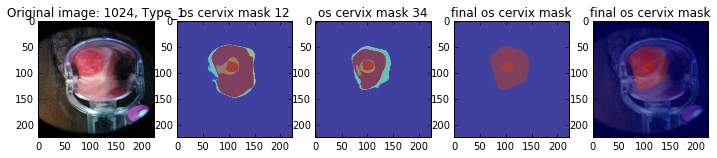

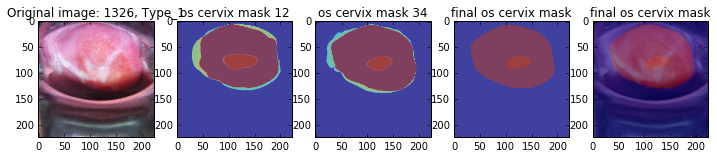

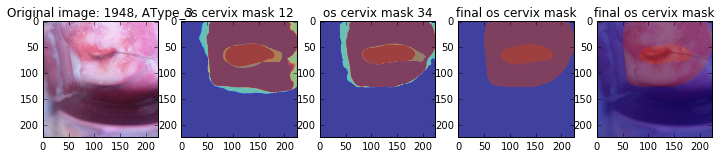

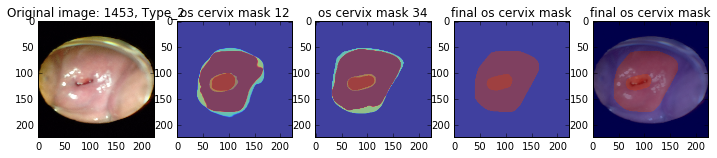

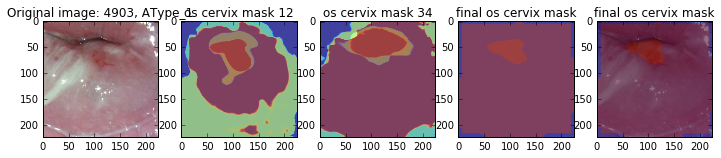

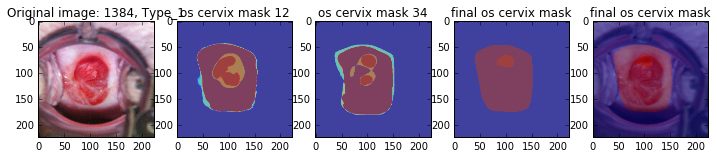

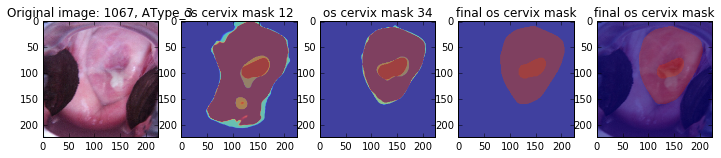

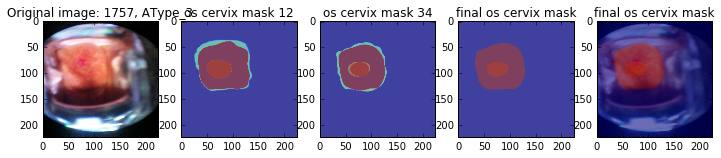

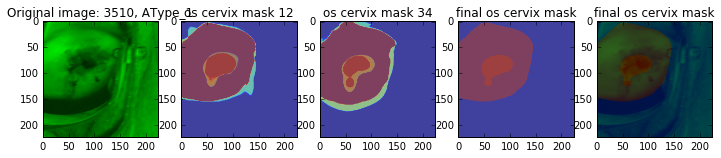

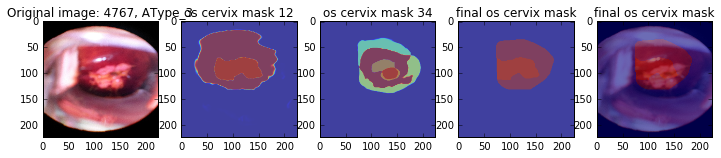

In [13]:
import cv2
import numpy as np
from postprocessing_utils import os_cervix_postproc

# id_type_list = [('1013', 'Type_1'), 
#                 ('1061', 'Type_1'), 
#                 ('601', 'Type_2'), 
#                 ('633', 'Type_2'), 
#                 ('565', 'Type_3'), 
#                 ('141', 'Test'),
#                 ('265', 'Type_1'),
#                 ('1087', 'Type_2'),  
#                 ('493', 'Type_2'),  
#                 ('273', 'Type_3'),                  
#                 ('471', 'Type_1')]

def _resize(mask, size):
    mask = cv2.resize(mask, dsize=size, interpolation=cv2.INTER_NEAREST)
    return mask


def merge_masks(os_cervix_mask_1, os_cervix_mask_2, a=0.45, b=0.55):
    os_cervix_1_sum = np.sum(os_cervix_mask_1 > 0.5, axis=(0, 1))
    os_cervix_2_sum = np.sum(os_cervix_mask_2 > 0.5, axis=(0, 1))
    os_cervix_indices = np.abs(os_cervix_1_sum - os_cervix_2_sum) * 1.0 / (os_cervix_1_sum + os_cervix_2_sum + 1e-7)    
    
    final_os_cervix_mask = np.zeros_like(os_cervix_mask_1)    
    for i in range(2):
        if os_cervix_indices[i] < 0.5:
            final_os_cervix_mask[:,:,i] = a * os_cervix_mask_1[:,:,i] + b * os_cervix_mask_2[:,:,i]
        else:
            if os_cervix_1_sum[i] > os_cervix_2_sum[i]:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_1[:,:,i]
            else:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_2[:,:,i]
    return final_os_cervix_mask
    

for image_id, image_type in id_type_list:

    img = get_image_data(image_id, image_type)
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')
    os_cervix_mask_3 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_3')
    os_cervix_mask_4 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_4')
    
    img = _resize(img, os_cervix_mask_1.shape[:2][::-1])
        
#     print("os cervix mask 1 : ", np.sum(os_cervix_mask_1[:,:,0] > 0.5), np.sum(os_cervix_mask_1[:,:,1] > 0.5))    
#     print("os cervix mask 2 : ", np.sum(os_cervix_mask_2[:,:,0] > 0.5), np.sum(os_cervix_mask_2[:,:,1] > 0.5))    
#     print("os cervix mask 3 : ", np.sum(os_cervix_mask_3[:,:,0] > 0.5), np.sum(os_cervix_mask_3[:,:,1] > 0.5))    
#     print("os cervix mask 4 : ", np.sum(os_cervix_mask_4[:,:,0] > 0.5), np.sum(os_cervix_mask_4[:,:,1] > 0.5))          
#     os_1 = np.sum(os_cervix_mask_1[:,:,0] > 0.5)
#     os_2 = np.sum(os_cervix_mask_2[:,:,0] > 0.5)
#     os_min = min(os_1, os_2)
#     cervix_1 = np.sum(os_cervix_mask_1[:,:,1] > 0.5)
#     cervix_2 = np.sum(os_cervix_mask_2[:,:,1] > 0.5)

#     os_index = np.abs(os_1 - os_2) * 1.0/(os_1 + os_2 + 1e-7)    
#     print("os_index: ", os_index)    
#     cervix_index = np.abs(cervix_1 - cervix_2) * 1.0 /(cervix_1 + cervix_2)    
#     print("cervix_index: ", cervix_index)
        
    os_cervix_mask_12 = merge_masks(os_cervix_mask_1, os_cervix_mask_2)
    os_cervix_mask_34 = merge_masks(os_cervix_mask_3, os_cervix_mask_4)
    
    final_os_cervix_mask_1 = merge_masks(os_cervix_mask_34, os_cervix_mask_12)
    final_os_cervix_mask_2 = os_cervix_postproc(final_os_cervix_mask_1)
    
    plt_st(12, 6)
    plt.subplot(151)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(152)
#     plt.imshow(os_cervix_mask_1[:,:,0], alpha=0.5, cmap='jet')    
#     plt.imshow(os_cervix_mask_1[:,:,1], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_12[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_12[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 12")
    plt.subplot(153)
#     plt.imshow(os_cervix_mask_2[:,:,0], alpha=0.5, cmap='jet')
#     plt.imshow(os_cervix_mask_2[:,:,1], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_34[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_34[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 34")        
    plt.subplot(154)
    plt.imshow(final_os_cervix_mask_2[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(final_os_cervix_mask_2[:,:,1], alpha=0.5, cmap='jet')
    plt.title("final os cervix mask")        
    plt.subplot(155)
    plt.imshow(img)
    plt.imshow(final_os_cervix_mask_2[:,:,0], alpha=0.35, cmap='jet')
    plt.imshow(final_os_cervix_mask_2[:,:,1], alpha=0.35, cmap='jet')
    plt.title("final os cervix mask")        

## Create final os/cervix bbox 

In [14]:
import cv2
from postprocessing_utils import get_bbox
from postprocessing_utils import os_cervix_postproc

In [17]:
no_os_detected_id_type_list = []
no_cervix_detected_id_type_list = []
image_size = (299, 299)

counter = 1
ll = len(all_trainval_id_type_list)
for image_id, image_type in all_trainval_id_type_list:
    
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')    
    os_cervix_mask_3 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_3')
    os_cervix_mask_4 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_4')    
    
    os_cervix_mask_12 = merge_masks(os_cervix_mask_1, os_cervix_mask_2)
    os_cervix_mask_34 = merge_masks(os_cervix_mask_3, os_cervix_mask_4)    
    final_os_cervix_mask = merge_masks(os_cervix_mask_34, os_cervix_mask_12)    
    final_os_cervix_mask = os_cervix_postproc(final_os_cervix_mask)    
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   
    counter += 1
    os_cervix = cv2.resize(final_os_cervix_mask, dsize=image_size, interpolation=cv2.INTER_NEAREST)
    cervix_mask = os_cervix[:, :, 1]
    if np.sum(cervix_mask) > 0:
        cervix_bbox = get_bbox(cervix_mask)        
        
        os_mask = os_cervix[:, :, 0]
        if np.sum(os_mask) > 0:
            os_bbox = get_bbox(os_mask)
        else:
            # set cervix instead of os
            print("No os detected on the image: %s, %s" % (image_id, image_type))
            no_os_detected_id_type_list.append((image_id, image_type))
            os_bbox = cervix_bbox

        filename = get_filename(image_id + '_' + image_type, 'os_cervix_bbox')
        if os.path.exists(filename):
            continue
        np.savez(filename, os_bbox=os_bbox, cervix_bbox=cervix_bbox, image_size=image_size)
    else:
        print("No cervix detected on the image: %s, %s" % (image_id, image_type))
        no_cervix_detected_id_type_list.append((image_id, image_type))
                

-- 1 / 2190 : 2391, AType_1
-- 2 / 2190 : 5408, AType_1
-- 3 / 2190 : 846, Type_1
-- 4 / 2190 : 1791, AType_1
-- 5 / 2190 : 6062, AType_1
-- 6 / 2190 : 6591, AType_1
-- 7 / 2190 : 1506, AType_1
-- 8 / 2190 : 6370, AType_1
-- 9 / 2190 : 1717, AType_1
-- 10 / 2190 : 2365, AType_1
-- 11 / 2190 : 5774, AType_1
-- 12 / 2190 : 3664, AType_1
-- 13 / 2190 : 346, Type_1
-- 14 / 2190 : 1523, AType_1
-- 15 / 2190 : 814, Type_1
-- 16 / 2190 : 2176, AType_1
-- 17 / 2190 : 3886, AType_1
-- 18 / 2190 : 578, Type_1
-- 19 / 2190 : 1223, Type_1
-- 20 / 2190 : 205, Type_1
-- 21 / 2190 : 788, AType_1
-- 22 / 2190 : 272, AType_1
-- 23 / 2190 : 5358, AType_1
-- 24 / 2190 : 1087, AType_1
-- 25 / 2190 : 729, AType_1
-- 26 / 2190 : 4690, AType_1
-- 27 / 2190 : 3996, AType_1
No os detected on the image: 3996, AType_1
-- 28 / 2190 : 6431, AType_1
-- 29 / 2190 : 935, AType_1
-- 30 / 2190 : 5983, AType_1
-- 31 / 2190 : 4029, AType_1
-- 32 / 2190 : 2664, AType_1
-- 33 / 2190 : 6256, AType_1
-- 34 / 2190 : 958, ATyp

In [47]:
counter = 1
ll = len(test_id_type_list)
for image_id, image_type in test_id_type_list:
    
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')    
    os_cervix_mask_3 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_3')
    os_cervix_mask_4 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_4')    
    
    os_cervix_mask_12 = merge_masks(os_cervix_mask_1, os_cervix_mask_2)
    os_cervix_mask_34 = merge_masks(os_cervix_mask_3, os_cervix_mask_4)    
    final_os_cervix_mask = merge_masks(os_cervix_mask_34, os_cervix_mask_12)    
    final_os_cervix_mask = os_cervix_postproc(final_os_cervix_mask)    
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   
    
    os_cervix = cv2.resize(final_os_cervix_mask, dsize=image_size, interpolation=cv2.INTER_NEAREST)
    cervix_mask = os_cervix[:, :, 1]
    if np.sum(cervix_mask) > 0:
        cervix_bbox = get_bbox(cervix_mask)        
        
        os_mask = os_cervix[:, :, 0]
        if np.sum(os_mask) > 0:
            os_bbox = get_bbox(os_mask)
        else:
            # set cervix instead of os
            print("No os detected on the image: %s, %s" % (image_id, image_type))
            no_os_detected_id_type_list.append((image_id, image_type))
            os_bbox = cervix_bbox

        filename = get_filename(image_id + '_' + image_type, 'os_cervix_bbox')
        np.savez(filename, os_bbox=os_bbox, cervix_bbox=cervix_bbox, image_size=image_size)
    else:
        print("No cervix detected on the image: %s, %s" % (image_id, image_type))
        no_cervix_detected_id_type_list.append((image_id, image_type))
                
    counter += 1

-- 1 / 512 : 0, Test


[autoreload of image_utils failed: Traceback (most recent call last):
  File "/usr/local/lib/python2.7/site-packages/IPython/extensions/autoreload.py", line 247, in check
    superreload(m, reload, self.old_objects)
  File "/Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/common/image_utils.py", line 24
    def imwrite(img, image_id, image_type):
      ^
IndentationError: expected an indented block
]


-- 2 / 512 : 1, Test
-- 3 / 512 : 10, Test
-- 4 / 512 : 100, Test
-- 5 / 512 : 101, Test
-- 6 / 512 : 102, Test
-- 7 / 512 : 103, Test
-- 8 / 512 : 104, Test
-- 9 / 512 : 105, Test
-- 10 / 512 : 106, Test
-- 11 / 512 : 107, Test
-- 12 / 512 : 108, Test
-- 13 / 512 : 109, Test
-- 14 / 512 : 11, Test
-- 15 / 512 : 110, Test
-- 16 / 512 : 111, Test
-- 17 / 512 : 112, Test
-- 18 / 512 : 113, Test
-- 19 / 512 : 114, Test
-- 20 / 512 : 115, Test
-- 21 / 512 : 116, Test
-- 22 / 512 : 117, Test
-- 23 / 512 : 118, Test
-- 24 / 512 : 119, Test
-- 25 / 512 : 12, Test
-- 26 / 512 : 120, Test
-- 27 / 512 : 121, Test
-- 28 / 512 : 122, Test
-- 29 / 512 : 123, Test
-- 30 / 512 : 124, Test
-- 31 / 512 : 125, Test
-- 32 / 512 : 126, Test
-- 33 / 512 : 127, Test
-- 34 / 512 : 128, Test
-- 35 / 512 : 129, Test
-- 36 / 512 : 13, Test
-- 37 / 512 : 130, Test
-- 38 / 512 : 131, Test
-- 39 / 512 : 132, Test
-- 40 / 512 : 133, Test
-- 41 / 512 : 134, Test
-- 42 / 512 : 135, Test
-- 43 / 512 : 136, Test
-- 44 

In [48]:
no_cervix_detected_id_type_list, no_os_detected_id_type_list

([],
 [('632', 'AType_1'),
  ('6181', 'AType_1'),
  ('6157', 'AType_1'),
  ('5945', 'AType_1'),
  ('3059', 'AType_1'),
  ('6063', 'AType_1'),
  ('3415', 'AType_1'),
  ('2995', 'AType_1'),
  ('5947', 'AType_1'),
  ('6589', 'AType_1'),
  ('3996', 'AType_1'),
  ('1491', 'AType_1'),
  ('772', 'Type_2'),
  ('136', 'Type_2'),
  ('21', 'Type_2'),
  ('699', 'Type_2'),
  ('974', 'Type_2'),
  ('486', 'Type_2'),
  ('6346', 'AType_3'),
  ('132', 'Type_3'),
  ('3610', 'AType_3'),
  ('1357', 'AType_3'),
  ('6184', 'AType_3'),
  ('6009', 'AType_3'),
  ('4173', 'AType_3'),
  ('4581', 'AType_3'),
  ('6541', 'AType_3'),
  ('6689', 'AType_3'),
  ('3953', 'AType_3'),
  ('253', 'Test')])

In [11]:
from image_utils import get_image_bbox
# id_type_list = [('1013', 'Type_1'), 
#                 ('1061', 'Type_1'), 
#                 ('601', 'Type_2'), 
#                 ('633', 'Type_2'), 
#                 ('565', 'Type_3'), 
#                 ('141', 'Test'),
#                 ('265', 'Type_1'),
#                 ('1087', 'Type_2'),  
#                 ('493', 'Type_2'),  
#                 ('273', 'Type_3'),                  
#                 ('471', 'Type_1')]

for image_id, image_type in id_type_list:
    key = (image_id, image_type)
    if key not in cache:
        img = get_image_data(image_id, image_type)
    else:
        img = cache.get(key)
    
    os_bbox, cervix_bbox, image_size = get_image_bbox(image_id + "_" + image_type, 'os_cervix_bbox')
    
    if img.shape[:2] != image_size:
        img = cv2.resize(img, dsize=image_size)

    os_img = img[os_bbox[1]:os_bbox[3], os_bbox[0]:os_bbox[2], :]
    cervix_img = img[cervix_bbox[1]:cervix_bbox[3], cervix_bbox[0]:cervix_bbox[2], :]   
    
    os_img = cv2.resize(os_img, dsize=image_size)
    cervix_img = cv2.resize(cervix_img, dsize=image_size)
        
    plt_st(12, 6)
    plt.subplot(131)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(132)
    plt.imshow(os_img)    
    plt.title("Os image")
    plt.subplot(133)
    plt.imshow(cervix_img)    
    plt.title("Cervix image")

IOError: [Errno 2] No such file or directory: '/Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/os_cervix_bbox/248_Type_1.npz'

## Display all generated training data

In [8]:
def get_os_image(image_id, image_type, cache=None):
    os_bbox, cervix_bbox, image_size = get_image_bbox(image_id + "_" + image_type, 'os_cervix_bbox')
    if cache is not None:
        key = (image_id, image_type)
        if key in cache:
            img = cache.get(key)
        else:
            img = get_image_data(image_id, image_type)
            cache.put(key, img)
    else:
        img = get_image_data(image_id, image_type)        
    if img.shape[:2] != image_size:
        img = cv2.resize(img, dsize=image_size)
    os_img = img[os_bbox[1]:os_bbox[3], os_bbox[0]:os_bbox[2], :]
    os_img = cv2.resize(os_img, dsize=image_size)
    return os_img
    
    
def get_cervix_image(image_id, image_type, cache=None):
    os_bbox, cervix_bbox, image_size = get_image_bbox(image_id + "_" + image_type, 'os_cervix_bbox')
    if cache is not None:
        key = (image_id, image_type)
        if key in cache:
            img = cache.get(key)
        else:
            img = get_image_data(image_id, image_type)
            cache.put(key, img)            
    else:
        img = get_image_data(image_id, image_type)        
    if img.shape[:2] != image_size:
        img = cv2.resize(img, dsize=image_size)
    cervix_img = img[cervix_bbox[1]:cervix_bbox[3], cervix_bbox[0]:cervix_bbox[2], :]   
    cervix_img = cv2.resize(cervix_img, dsize=image_size)
    return cervix_img

In [74]:
# tile_size = (224, 224)
# n = 15

# complete_image = []
# m = int(np.ceil(len(all_trainval_id_type_list) * 1.0 / n))
# complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
# counter = 0
# id_type_list = sorted(all_trainval_id_type_list)
# for i in range(m):
#     ys = i*(tile_size[1] + 2)
#     ye = ys + tile_size[1]
#     for j in range(n):
#         xs = j*(tile_size[0] + 2)
#         xe = xs + tile_size[0]
#         if counter == len(id_type_list):
#             break
#         image_id, image_type = id_type_list[counter]; counter+=1
#         print "--", counter, "/", len(id_type_list), image_id, image_type
#         img = get_os_image(image_id, image_type, cache)
#         img = cv2.resize(img, dsize=tile_size)
#         img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
#         complete_image[ys:ye, xs:xe, :] = img[:,:,:]
#     if counter == len(id_type_list):
#         break

In [75]:
# m = complete_image.shape[0] / (tile_size[0] + 2)
# n = int(np.ceil(m / 15.0))
# for i in range(n):
#     plt_st(20, 20)
#     ys = i*(tile_size[0] + 2)*15
#     ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
#     plt.imshow(complete_image[ys:ye,:,:])
#     plt.title("Os training dataset of type %i, part %i" % (index + 1, i))

In [83]:
id_type_list = sorted(all_trainval_id_type_list)[:n_images_per_class]

tile_size = (224, 224)
n = 15

complete_image = []
m = int(np.ceil(len(id_type_list) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0

for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(id_type_list):
            break
        image_id, image_type = id_type_list[counter]; counter+=1
        print "--", counter, "/", len(id_type_list), image_id, image_type        
        img = get_cervix_image(image_id, image_type, cache)
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255, 255, 255), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(id_type_list):
        break         

-- 1 / 730 10 Type_1
-- 2 / 730 100 Type_2
-- 3 / 730 1000 AType_1
-- 4 / 730 1000 Type_3
-- 5 / 730 1001 AType_1
-- 6 / 730 1001 Type_2
-- 7 / 730 1002 Type_2
-- 8 / 730 1005 AType_1
-- 9 / 730 1005 Type_2
-- 10 / 730 1006 Type_2
-- 11 / 730 1009 AType_1
-- 12 / 730 1009 Type_3
-- 13 / 730 101 Type_2
-- 14 / 730 1010 AType_3
-- 15 / 730 1010 Type_2
-- 16 / 730 1011 AType_1
-- 17 / 730 1011 Type_2
-- 18 / 730 1012 Type_2
-- 19 / 730 1013 Type_1
-- 20 / 730 1014 AType_3
-- 21 / 730 1014 Type_1
-- 22 / 730 1016 Type_2
-- 23 / 730 1017 Type_2
-- 24 / 730 1018 Type_2
-- 25 / 730 102 Type_1
-- 26 / 730 1021 Type_2
-- 27 / 730 1022 Type_2
-- 28 / 730 1023 Type_1
-- 29 / 730 1025 Type_2
-- 30 / 730 1027 AType_3
-- 31 / 730 1027 Type_1
-- 32 / 730 1028 Type_3
-- 33 / 730 103 Type_2
-- 34 / 730 1030 Type_3
-- 35 / 730 1032 Type_2
-- 36 / 730 1034 Type_3
-- 37 / 730 1035 Type_2
-- 38 / 730 1036 AType_1
-- 39 / 730 1036 Type_2
-- 40 / 730 1038 Type_2
-- 41 / 730 1039 Type_2
-- 42 / 730 104 AType_

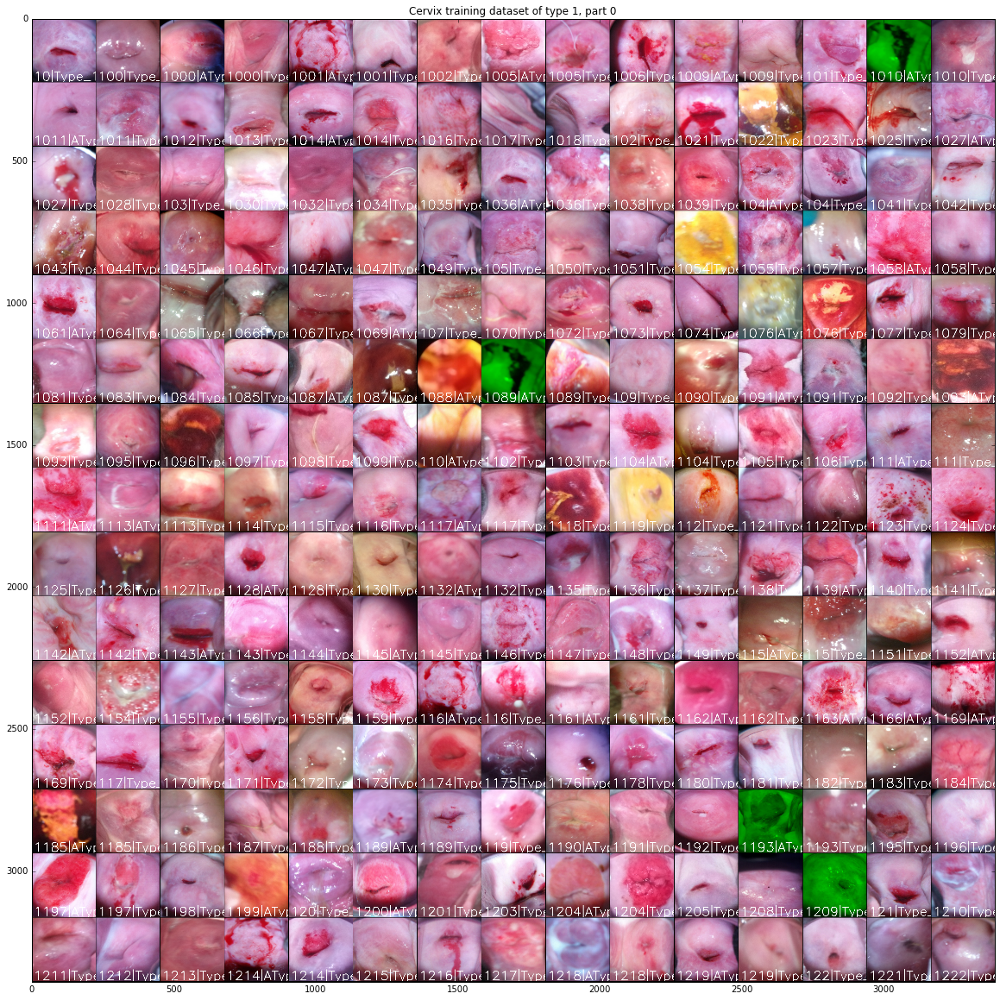

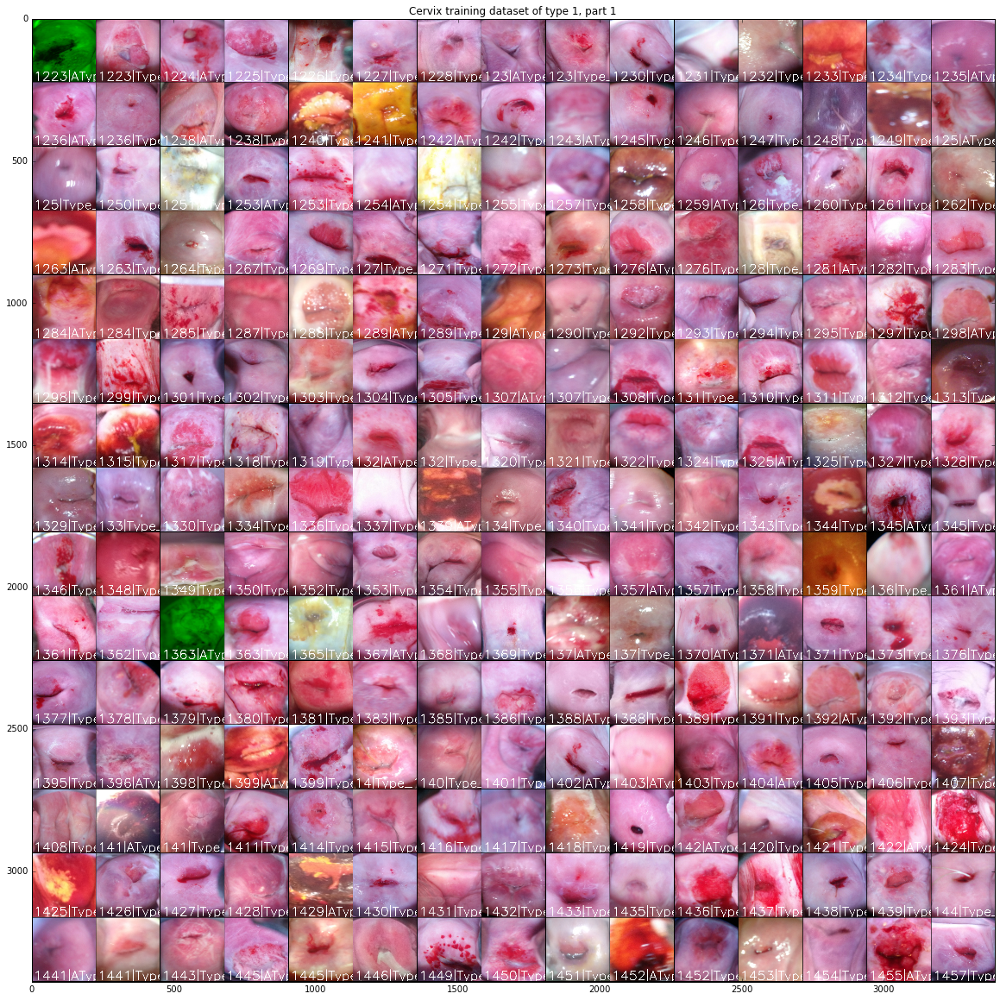

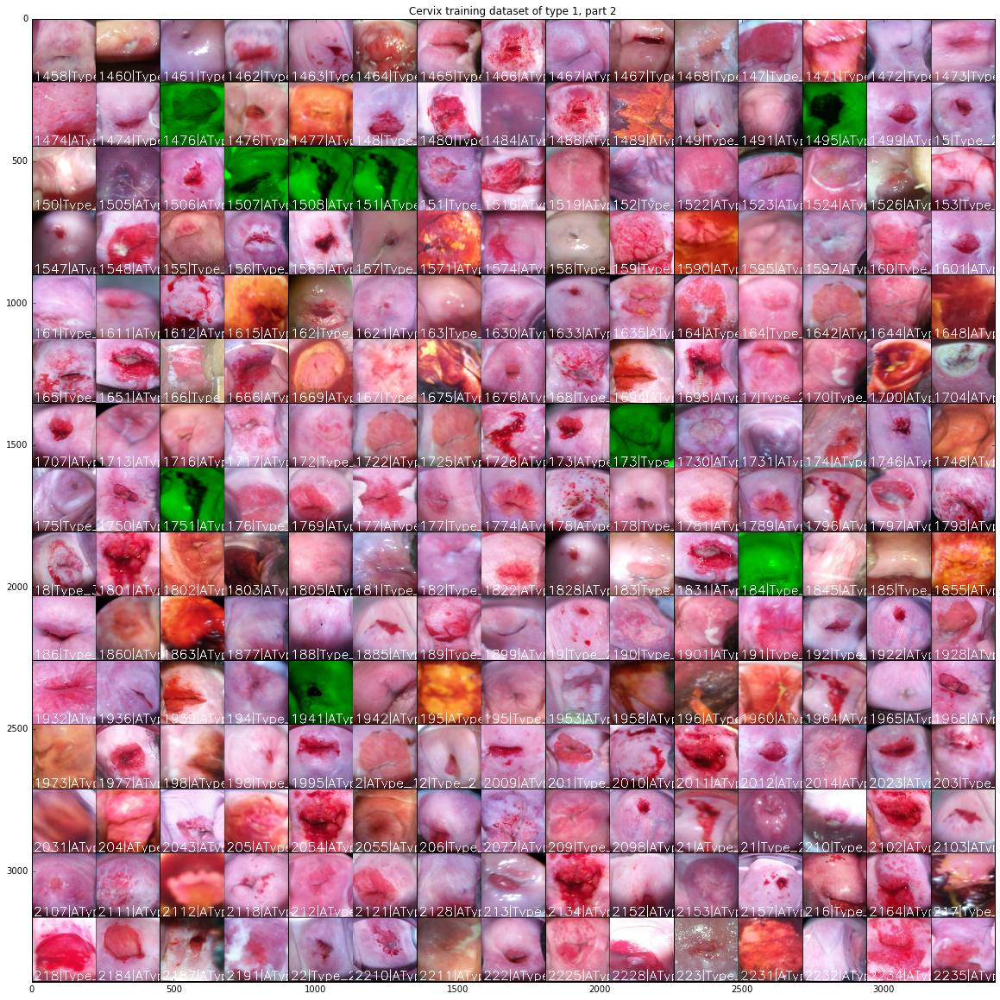

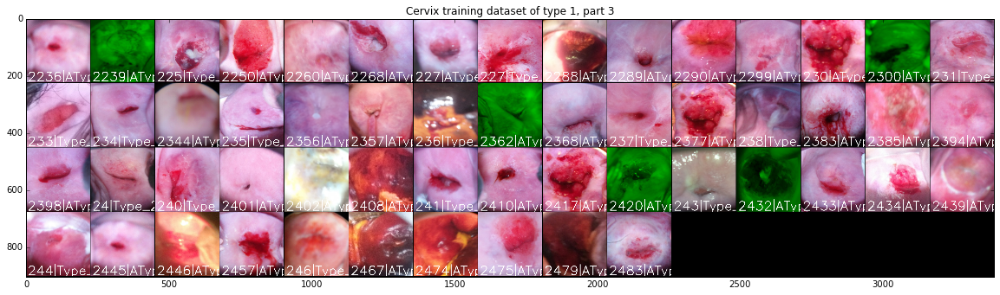

In [84]:
m = complete_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*15
    ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (1, i))

In [17]:
id_type_list = sorted(all_trainval_id_type_list)[n_images_per_class:2*n_images_per_class]

tile_size = (224, 224)
n = 15

complete_image = []
m = int(np.ceil(len(id_type_list) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0

for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(id_type_list):
            break
        image_id, image_type = id_type_list[counter]; counter+=1
        print "--", counter, "/", len(id_type_list), image_id, image_type        
        img = get_cervix_image(image_id, image_type, cache)
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(id_type_list):
        break         

-- 1 / 730 248 Type_1


IOError: [Errno 2] No such file or directory: '/Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/os_cervix_bbox/248_Type_1.npz'

In [ ]:
m = complete_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*15
    ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))

In [ ]:
id_type_list = sorted(all_trainval_id_type_list)[2*n_images_per_class:]

tile_size = (224, 224)
n = 15

complete_image = []
m = int(np.ceil(len(id_type_list) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0

for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(id_type_list):
            break
        image_id, image_type = id_type_list[counter]; counter+=1
        print "--", counter, "/", len(id_type_list), image_id, image_type        
        img = get_cervix_image(image_id, image_type, cache)
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(id_type_list):
        break         

-- 1 / 730 2489 AType_3
-- 2 / 730 2496 AType_1
-- 3 / 730 25 AType_1
-- 4 / 730 25 Type_3
-- 5 / 730 250 Type_2
-- 6 / 730 2507 AType_1
-- 7 / 730 251 Type_2
-- 8 / 730 252 AType_1
-- 9 / 730 252 Type_1
-- 10 / 730 2525 AType_1
-- 11 / 730 254 Type_1
-- 12 / 730 2551 AType_1
-- 13 / 730 2568 AType_3
-- 14 / 730 257 AType_1
-- 15 / 730 257 Type_2
-- 16 / 730 2575 AType_1
-- 17 / 730 2586 AType_3
-- 18 / 730 2590 AType_1
-- 19 / 730 2596 AType_1
-- 20 / 730 2598 AType_1
-- 21 / 730 26 AType_3
-- 22 / 730 26 Type_2
-- 23 / 730 260 Type_3
-- 24 / 730 2604 AType_1
-- 25 / 730 261 AType_3
-- 26 / 730 261 Type_3
-- 27 / 730 2615 AType_3
-- 28 / 730 2622 AType_1
-- 29 / 730 2625 AType_3
-- 30 / 730 263 Type_3
-- 31 / 730 2630 AType_1
-- 32 / 730 264 Type_2
-- 33 / 730 2644 AType_1
-- 34 / 730 2649 AType_3
-- 35 / 730 265 AType_1
-- 36 / 730 266 Type_2
-- 37 / 730 2664 AType_1
-- 38 / 730 2667 AType_3
-- 39 / 730 267 Type_1
-- 40 / 730 2676 AType_3
-- 41 / 730 268 Type_2
-- 42 / 730 2682 AType

In [ ]:
m = complete_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*15
    ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))

## Display all test images

In [42]:
import cv2

In [43]:
tile_size = (256, 256)
n = 15
m = int(np.ceil(len(test_ids) * 1.0 / n))
complete_test_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(test_ids):
            break
        image_id = test_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Test_os')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
        complete_test_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(test_ids):
        break

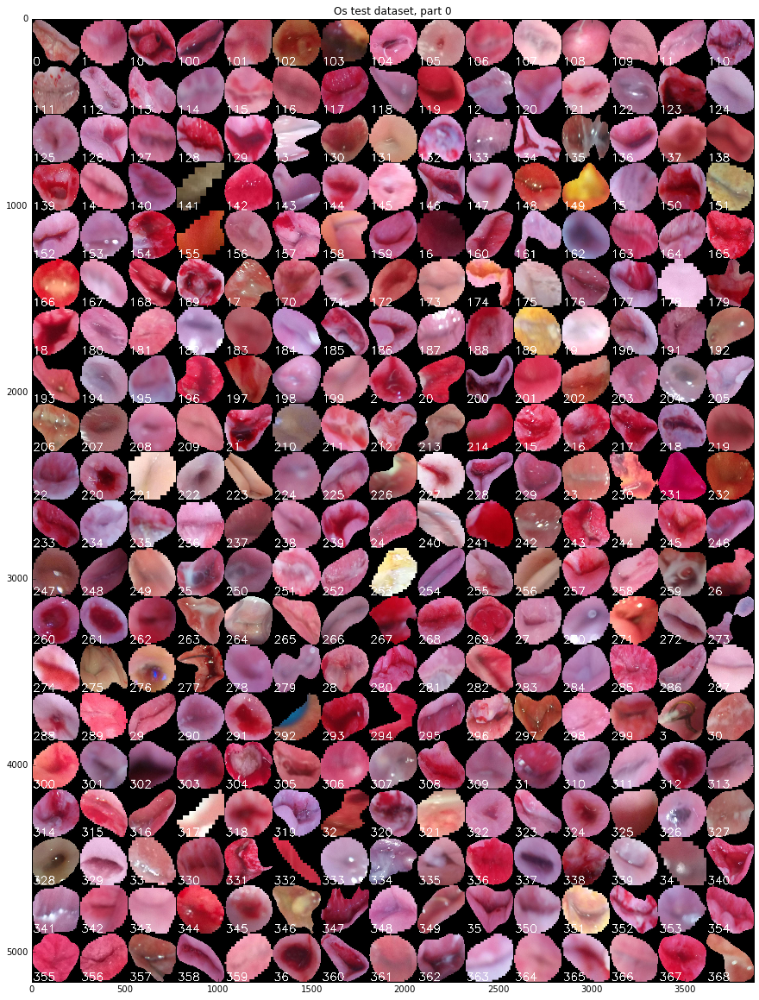

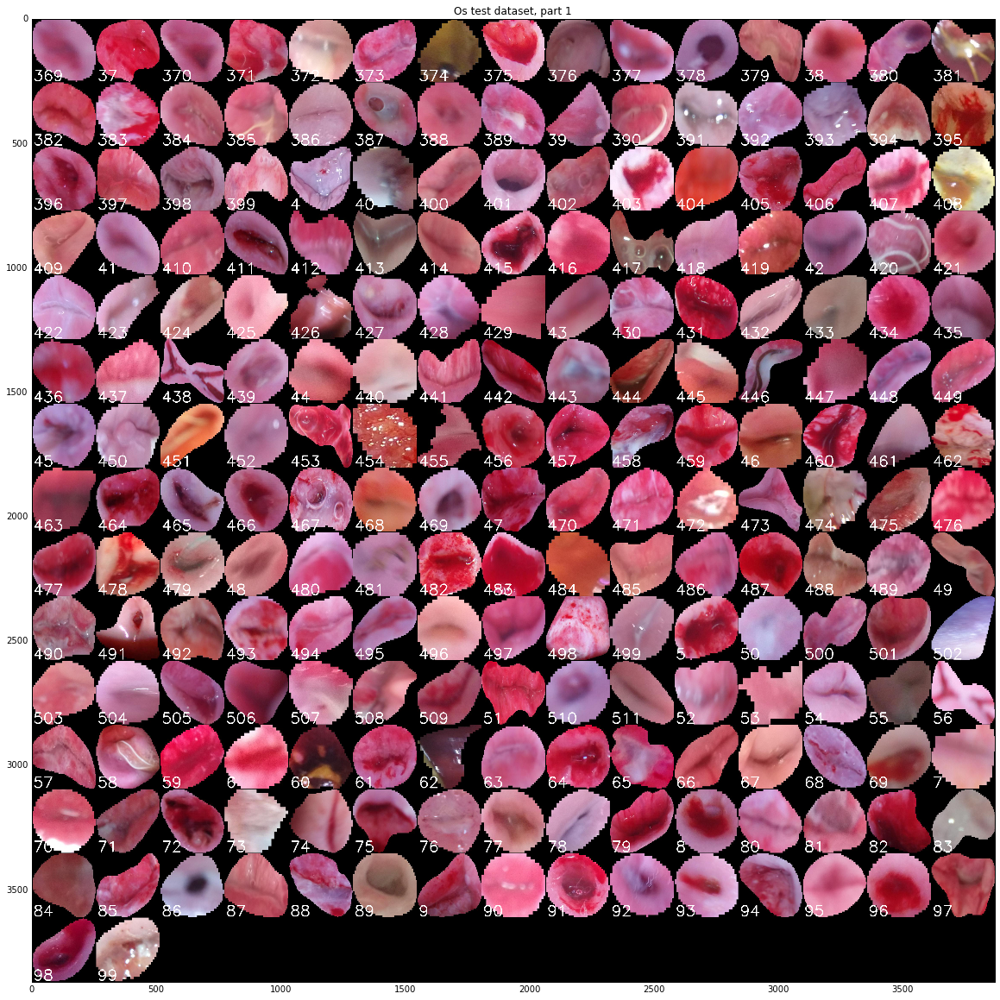

In [44]:
m = complete_test_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m * 1.0 / 20.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_test_image.shape[0])
    plt.imshow(complete_test_image[ys:ye,:,:])
    plt.title("Os test dataset, part %i" % (i))

In [45]:
len(test_ids)

512

In [46]:
tile_size = (256, 256)
n = 15
m = int(np.ceil(len(test_ids) * 1.0 / n))
complete_test_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(test_ids):
            break
        image_id = test_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Test_cervix')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
        complete_test_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(test_ids):
        break

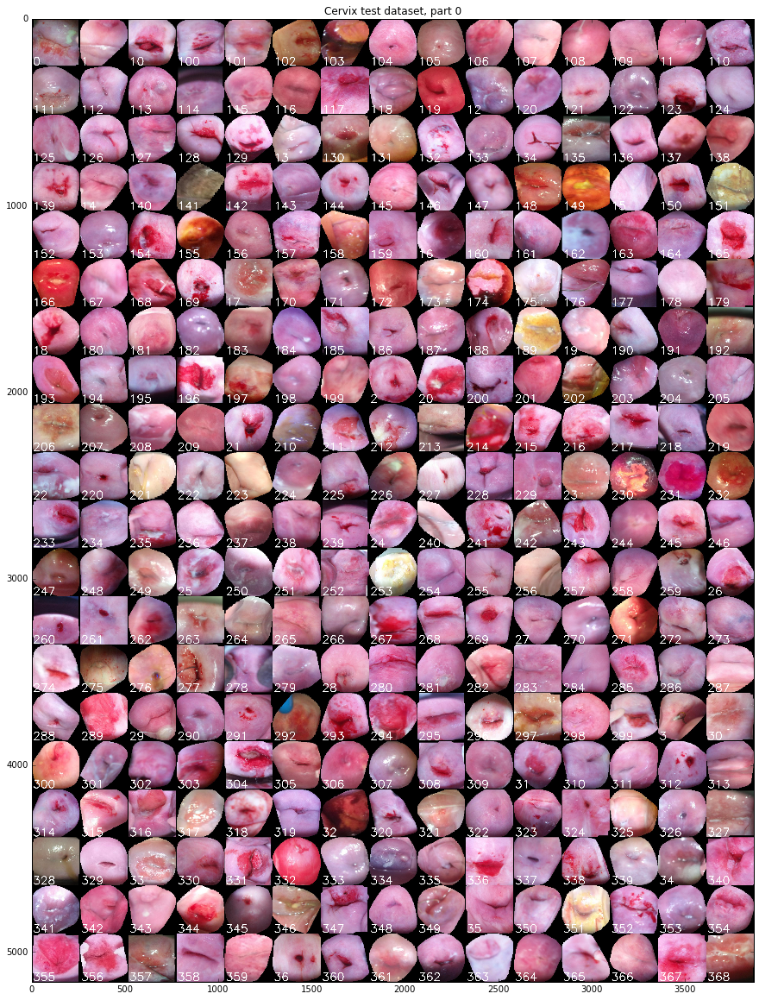

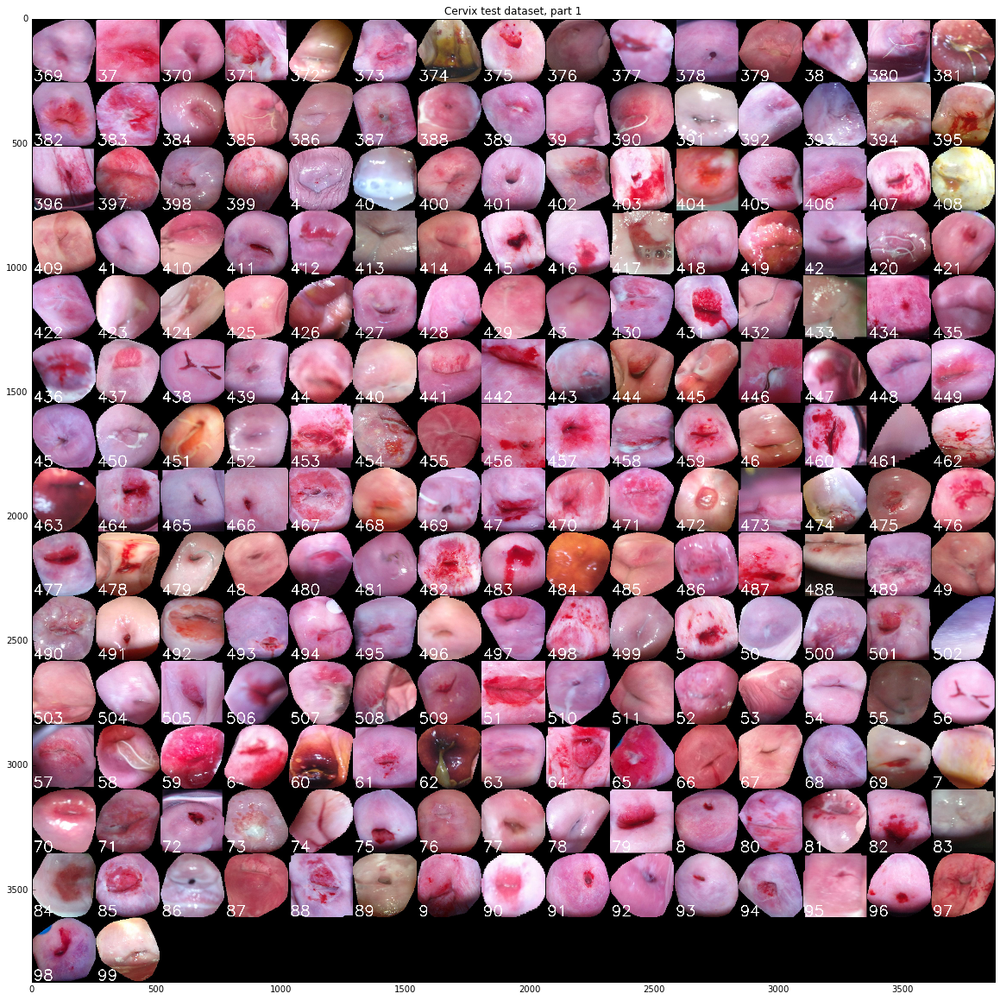

In [47]:
m = complete_test_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m * 1.0/ 20.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_test_image.shape[0])
    plt.imshow(complete_test_image[ys:ye,:,:])
    plt.title("Cervix test dataset, part %i" % (i))